# Feature Selection

In [95]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

In [96]:
# Load the dataset
df = pd.read_csv("../../Datasets/Companies/SmallCompanies.csv")

df.head()

,unique_id,disbursement_date,loan_investment_amount,lender_insurance_premium,metro_type,LMI_type,revenue,full_time_employees,naics_code,jobs_created,lender_type_category,optional_primary_use_of_funds,optional_revenue_yr_confirmed,optional_stage,active_status,support_amount
0,AK_2013_VCP_1,3/1/2013,180000.0,0.0,Metro,Non-LMI,0.0,5.0,541511,3.0,Loan Fund,"Wages, Working Capital, & Professional Services",2014.0,Early Stage,Unknown,0.0
1,AK_2013_VCP_3,12/30/2013,265000.0,0.0,Metro,Non-LMI,0.0,7.0,541511,2.0,Loan Fund,"Wages, Working Capital, & Professional Services",2014.0,Early Stage,Unknown,0.0
2,AK_2014_VCP_1,4/11/2014,199500.0,0.0,Metro,Non-LMI,0.0,2.0,336612,8.0,Loan Fund,"Wages, Working Capital, & Professional Services",2014.0,Early Stage,Unknown,0.0
3,AK_2014_VCP_2,5/15/2014,125000.0,0.0,Metro,LMI,1494916.0,8.0,451110,8.0,Loan Fund,"Wages, Working Capital, & Professional Services",2014.0,Early Stage,Unknown,0.0
4,AK_2014_VCP_3,9/15/2014,120000.0,0.0,Metro,Non-LMI,41000.0,0.0,336612,0.0,Loan Fund,"Wages, Working Capital, & Professional Services",2014.0,Early Stage,Unknown,0.0


In [97]:
print("Dataset dimensions:", df.shape)

Dataset dimensions: (18584, 16)


In [98]:
# Get concise summary of the dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18584 entries, 0 to 18583
Data columns (total 16 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   unique_id                      18584 non-null  object 
 1   disbursement_date              18584 non-null  object 
 2   loan_investment_amount         18584 non-null  float64
 3   lender_insurance_premium       18584 non-null  float64
 4   metro_type                     18584 non-null  object 
 5   LMI_type                       18584 non-null  object 
 6   revenue                        18584 non-null  float64
 7   full_time_employees            18584 non-null  float64
 8   naics_code                     18584 non-null  int64  
 9   jobs_created                   18584 non-null  float64
 10  lender_type_category           18584 non-null  object 
 11  optional_primary_use_of_funds  18584 non-null  object 
 12  optional_revenue_yr_confirmed  18584 non-null 

In [99]:
# Filter out the categorical columns
categorical_columns = df.select_dtypes(include=['object']).columns

# Calculate the number of unique values for each categorical column
unique_counts_categorical = df[categorical_columns].nunique()

unique_counts_categorical

unique_id                        18563
disbursement_date                 1572
metro_type                           2
LMI_type                             2
lender_type_category                 6
optional_primary_use_of_funds        5
optional_stage                       5
active_status                       10
dtype: int64

In [100]:
df=df[df['active_status']!='Unknown']

In [101]:
different_active_statuses = df['active_status'].unique()

print(different_active_statuses)

['Did not attempt to confirm operations' 'Yes'
 'Attempted to confirm operations, but unable' 'Other' 'Sold' 'Exit'
 'Loss' 'Bankrupt' 'Moved']


In [102]:
different_supportAmount=df['support_amount'].unique()
print(different_supportAmount)

[8.00000000e+04 1.80000000e+05 2.25600000e+05 2.50000000e+04
 1.72000000e+04 7.00000000e+03 1.14300000e+05 1.50000000e+04
 1.75000000e+04 1.20000000e+05 5.60000000e+04 2.80000000e+04
 4.49650000e+04 2.01000000e+05 4.00000000e+04 6.00000000e+04
 1.60000000e+04 2.01600000e+05 2.73600000e+05 3.20000000e+04
 4.80000000e+04 4.00000000e+05 1.12500000e+04 2.00000000e+04
 5.92798400e+05 2.07200000e+05 6.72000000e+05 2.40000000e+05
 1.60000000e+05 3.50000000e+05 4.20000000e+05 5.00000000e+04
 6.27880000e+04 2.40000000e+04 5.20000000e+05 4.65762000e+05
 5.34214900e+05 7.50000000e+03 5.50000000e+03 9.60000000e+04
 1.04000000e+05 1.08000000e+05 3.84000000e+04 1.92000000e+05
 1.16800000e+05 1.00000000e+04 1.25000000e+04 1.75000000e+05
 3.50000000e+04 3.91940000e+05 4.20000000e+04 1.95000000e+05
 4.42500000e+05 2.00000000e+05 1.13100000e+05 1.17000000e+05
 3.60000000e+04 8.49485900e+04 1.00000000e+05 3.81080000e+04
 3.36000000e+05 9.04000000e+04 9.20000000e+04 6.22000000e+04
 7.20000000e+04 3.750000

## Encoding

In [103]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4050 entries, 778 to 18583
Data columns (total 16 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   unique_id                      4050 non-null   object 
 1   disbursement_date              4050 non-null   object 
 2   loan_investment_amount         4050 non-null   float64
 3   lender_insurance_premium       4050 non-null   float64
 4   metro_type                     4050 non-null   object 
 5   LMI_type                       4050 non-null   object 
 6   revenue                        4050 non-null   float64
 7   full_time_employees            4050 non-null   float64
 8   naics_code                     4050 non-null   int64  
 9   jobs_created                   4050 non-null   float64
 10  lender_type_category           4050 non-null   object 
 11  optional_primary_use_of_funds  4050 non-null   object 
 12  optional_revenue_yr_confirmed  4050 non-null   flo

In [104]:
from sklearn.preprocessing import LabelEncoder

# Initialize LabelEncoder
label_encoder = LabelEncoder()

# Iterate through each categorical column
for column in df.select_dtypes(include=['object']):
    # Convert 'Yes' values to 1 and all others to 0 for 'active_status' column
    if column == 'active_status':
        df[column] = df[column].apply(lambda x: 1 if x == 'Yes' else 0)
    else:
        # Apply label encoding to other categorical columns
        df[column] = label_encoder.fit_transform(df[column])

# Add a new column 'target' based on conditions
df['target'] = (df['active_status'] == 1) & (df['support_amount'] != 0)

# Convert boolean values to 1s and 0s
df['target'] = df['target'].astype(int)

df.head()


,unique_id,disbursement_date,loan_investment_amount,lender_insurance_premium,metro_type,LMI_type,revenue,full_time_employees,naics_code,jobs_created,lender_type_category,optional_primary_use_of_funds,optional_revenue_yr_confirmed,optional_stage,active_status,support_amount,target
778,8,462,100000.0,0.0,0,1,2027806.00,12.0,541330,0.0,0,4,2014.0,0,0,80000.0,0
800,24,705,240000.0,0.0,0,0,1662422.00,2.0,238220,0.0,0,4,2014.0,0,0,180000.0,0
802,31,713,282000.0,0.0,0,0,268058.00,11.0,722511,1.0,0,4,2014.0,0,0,225600.0,0
832,48,683,50000.0,0.0,0,1,254153.58,4.0,487210,0.0,4,4,2014.0,0,0,25000.0,0
847,57,809,21500.0,0.0,0,1,0.00,1.0,453310,0.0,0,4,2014.0,0,0,17200.0,0


In [105]:
# Remove 'active_status' and 'support_amount' columns
df.drop(['active_status', 'support_amount'], axis=1, inplace=True)

df.head()


,unique_id,disbursement_date,loan_investment_amount,lender_insurance_premium,metro_type,LMI_type,revenue,full_time_employees,naics_code,jobs_created,lender_type_category,optional_primary_use_of_funds,optional_revenue_yr_confirmed,optional_stage,target
778,8,462,100000.0,0.0,0,1,2027806.00,12.0,541330,0.0,0,4,2014.0,0,0
800,24,705,240000.0,0.0,0,0,1662422.00,2.0,238220,0.0,0,4,2014.0,0,0
802,31,713,282000.0,0.0,0,0,268058.00,11.0,722511,1.0,0,4,2014.0,0,0
832,48,683,50000.0,0.0,0,1,254153.58,4.0,487210,0.0,4,4,2014.0,0,0
847,57,809,21500.0,0.0,0,1,0.00,1.0,453310,0.0,0,4,2014.0,0,0


In [106]:
frequency = df['target'].value_counts()
frequency = frequency.reset_index()
frequency.columns = ['target', 'count']
print(frequency)

   target  count
0       0   3364
1       1    686


## Oversampling (Balance the dataset)

In [107]:
from sklearn.utils import resample

# Separate majority and minority classes
df_majority = df[df['target'] == 0]
df_minority = df[df['target'] == 1]

# Upsample minority class
df_minority_upsampled = resample(df_minority, 
                                 replace=True,     # sample with replacement
                                 n_samples=len(df_majority),  # match number in majority class
                                 random_state=42)  # reproducible results

# Combine majority class with upsampled minority class
df_balanced = pd.concat([df_majority, df_minority_upsampled])

# Display class counts
print(df_balanced['target'].value_counts())


target
0    3364
1    3364
Name: count, dtype: int64


## Devide the dataset into training data and forecasting data


In [108]:
from sklearn.model_selection import train_test_split

# Split the dataset into training and forecasting sets
train_df, forecast_df = train_test_split(df_balanced, test_size=0.4, random_state=42)

# Save training and forecasting sets to CSV files
train_df.to_csv('training_data.csv', index=False)
forecast_df.to_csv('forecasting_data.csv', index=False)


## Standardization

In [109]:
from sklearn.preprocessing import StandardScaler

# Initialize StandardScaler
scaler = StandardScaler()

scaled_train_df = pd.DataFrame(scaler.fit_transform(train_df), columns=df.columns)
scaled_train_df.head()
scaled_forecast_df = pd.DataFrame(scaler.fit_transform(forecast_df), columns=df.columns)
scaled_forecast_df.head()

,unique_id,disbursement_date,loan_investment_amount,lender_insurance_premium,metro_type,LMI_type,revenue,full_time_employees,naics_code,jobs_created,lender_type_category,optional_primary_use_of_funds,optional_revenue_yr_confirmed,optional_stage,target
0,-0.541441,-1.412968,-0.415541,-0.161262,-0.558472,-1.483560,-0.262640,-0.785141,0.623929,-0.158798,-1.038130,-1.691536,-2.254432,-0.261898,1.024825
1,-1.549630,0.738616,-0.318910,-0.161262,-0.558472,0.674054,-0.245446,0.529794,1.807988,-0.041956,0.701276,0.617990,-0.417588,-0.261898,-0.975776
2,0.031513,-1.535063,-0.267599,-0.161262,-0.558472,-1.483560,0.041501,2.370702,1.278170,-0.041956,0.701276,-0.151852,1.419255,-0.261898,1.024825
3,-0.653560,-1.179631,-0.404144,-0.161262,-0.558472,-1.483560,-0.273622,0.266807,1.814418,-0.353533,1.281079,0.617990,-0.417588,-0.261898,1.024825
4,1.359285,0.470007,-0.229583,-0.161262,-0.558472,0.674054,-0.273622,-1.048128,1.278158,0.035938,0.701276,-0.921694,0.500833,-0.261898,-0.975776


In [110]:
from sklearn.model_selection import train_test_split
#Split your data into features (X) and target variable (y)
X = scaled_train_df.drop(columns=['target'])  
y = train_df['target'] 

# Split your data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [17]:
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import itertools
import datetime

# List to store results
results = []

# Calculate total number of combinations
total_combinations = sum(len(list(itertools.combinations(X.columns, r))) for r in range(1, 7))

# Initialize counter for tracking progress
progress_counter = 0

# Loop through all possible combinations of features
for r in range(1, 7):  # considering combinations of 1 to 6 features
    feature_combinations = list(itertools.combinations(X.columns, r))
    for features in feature_combinations:
        # Logistic Regression
        lr_model = LogisticRegression()
        lr_model.fit(X_train[list(features)], y_train)
        lr_pred = lr_model.predict(X_test[list(features)])
        
        # Calculate evaluation metrics
        lr_accuracy = accuracy_score(y_test, lr_pred)
        lr_precision = precision_score(y_test, lr_pred)
        lr_recall = recall_score(y_test, lr_pred)
        lr_f1 = f1_score(y_test, lr_pred)

        for feature in features:
            results.append({
                'Feature': ', '.join(features),
                'Logistic Regression Accuracy': lr_accuracy,
                'Logistic Regression Precision': lr_precision,
                'Logistic Regression Recall': lr_recall,
                'Logistic Regression F1 Score': lr_f1
            })
        # Update progress
        progress_counter += 1
        print(f"Progress: {progress_counter}/{total_combinations}")

# Convert results to DataFrame for analysis
results_df = pd.DataFrame(results)
pd.set_option('display.max_rows', None)  # Display all rows without truncation
print(results_df)


# Save DataFrame to a CSV file with current date in the filename
results_df.to_csv(f"logistic_regression_results_SE.csv", index=False)

print(f"Results saved to 'logistic_regression_results_SE.csv'.")


Progress: 1/6475
Progress: 2/6475
Progress: 3/6475
Progress: 4/6475
Progress: 5/6475
Progress: 6/6475
Progress: 7/6475
Progress: 8/6475
Progress: 9/6475
Progress: 10/6475
Progress: 11/6475
Progress: 12/6475
Progress: 13/6475
Progress: 14/6475
Progress: 15/6475
Progress: 16/6475
Progress: 17/6475
Progress: 18/6475
Progress: 19/6475
Progress: 20/6475
Progress: 21/6475
Progress: 22/6475
Progress: 23/6475
Progress: 24/6475
Progress: 25/6475
Progress: 26/6475
Progress: 27/6475
Progress: 28/6475
Progress: 29/6475
Progress: 30/6475
Progress: 31/6475
Progress: 32/6475
Progress: 33/6475
Progress: 34/6475
Progress: 35/6475
Progress: 36/6475
Progress: 37/6475
Progress: 38/6475
Progress: 39/6475
Progress: 40/6475
Progress: 41/6475
Progress: 42/6475
Progress: 43/6475
Progress: 44/6475
Progress: 45/6475
Progress: 46/6475
Progress: 47/6475
Progress: 48/6475
Progress: 49/6475
Progress: 50/6475
Progress: 51/6475
Progress: 52/6475
Progress: 53/6475
Progress: 54/6475
Progress: 55/6475
Progress: 56/6475
P

In [111]:
import itertools
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import pandas as pd
import datetime

# List to store results
results = []

# Calculate total number of combinations
total_combinations = sum(len(list(itertools.combinations(X.columns, r))) for r in range(1, 7))

# Initialize counter for tracking progress
progress_counter = 0

# Loop through all possible combinations of features
for r in range(1, 7):  # considering combinations of 1 to 6 features
    feature_combinations = list(itertools.combinations(X.columns, r))
    for features in feature_combinations:
        # XGBoost Classifier
        xgb_model = XGBClassifier()
        xgb_model.fit(X_train[list(features)], y_train)
        xgb_pred = xgb_model.predict(X_test[list(features)])
        
        # Calculate evaluation metrics
        xgb_accuracy = accuracy_score(y_test, xgb_pred)
        xgb_precision = precision_score(y_test, xgb_pred)
        xgb_recall = recall_score(y_test, xgb_pred)
        xgb_f1 = f1_score(y_test, xgb_pred)

        # Store results
        for feature in features:
            results.append({
                'Feature': ', '.join(features),
                'XGBoost Accuracy': xgb_accuracy,
                'XGBoost Precision': xgb_precision,
                'XGBoost Recall': xgb_recall,
                'XGBoost F1 Score': xgb_f1
            })
        
        # Update progress
        progress_counter += 1
        print(f"Progress: {progress_counter}/{total_combinations}")

# Convert results to DataFrame for analysis
results_df = pd.DataFrame(results)


# Save DataFrame to a CSV file with current date in the filename
results_df.to_csv(f"xgboost_results_SE.csv", index=False)

print(f"Results saved to 'xgboost_results_SE.csv'.")


Progress: 1/6475
Progress: 2/6475
Progress: 3/6475
Progress: 4/6475
Progress: 5/6475
Progress: 6/6475
Progress: 7/6475
Progress: 8/6475
Progress: 9/6475
Progress: 10/6475
Progress: 11/6475
Progress: 12/6475
Progress: 13/6475
Progress: 14/6475
Progress: 15/6475
Progress: 16/6475
Progress: 17/6475
Progress: 18/6475
Progress: 19/6475
Progress: 20/6475
Progress: 21/6475
Progress: 22/6475
Progress: 23/6475
Progress: 24/6475
Progress: 25/6475
Progress: 26/6475
Progress: 27/6475
Progress: 28/6475
Progress: 29/6475
Progress: 30/6475
Progress: 31/6475
Progress: 32/6475
Progress: 33/6475
Progress: 34/6475
Progress: 35/6475
Progress: 36/6475
Progress: 37/6475
Progress: 38/6475
Progress: 39/6475
Progress: 40/6475
Progress: 41/6475
Progress: 42/6475
Progress: 43/6475
Progress: 44/6475
Progress: 45/6475
Progress: 46/6475
Progress: 47/6475
Progress: 48/6475
Progress: 49/6475
Progress: 50/6475
Progress: 51/6475
Progress: 52/6475
Progress: 53/6475
Progress: 54/6475
Progress: 55/6475
Progress: 56/6475
P

In [141]:
import itertools
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import pandas as pd
import datetime

# List to store results
results = []

# Calculate total number of combinations
total_combinations = sum(len(list(itertools.combinations(X.columns, r))) for r in range(1, 7))

# Initialize counter for tracking progress
progress_counter = 0

# Loop through all possible combinations of features
for r in range(1, 7):  # considering combinations of 1 to 6 features
    feature_combinations = list(itertools.combinations(X.columns, r))
    for features in feature_combinations:
       # Random Forest Classifier
        rf_model = RandomForestClassifier()
        rf_model.fit(X_train[list(features)], y_train)
        rf_pred = rf_model.predict(X_test[list(features)])
        rf_accuracy = accuracy_score(y_test, rf_pred)
        rf_precision = precision_score(y_test, rf_pred)
        rf_recall = recall_score(y_test, rf_pred)
        rf_f1 = f1_score(y_test, rf_pred)
        
        # Store results
        for feature in features:
            results.append({
                'Feature': ', '.join(features),
                'Random Forest Accuracy': rf_accuracy,
                'Random Forest Precision': rf_precision,
                'Random Forest Recall': rf_recall,
                'Random Forest F1 Score': rf_f1
            })

        # Update progress
        progress_counter += 1
        print(f"Progress: {progress_counter}/{total_combinations}")

# Convert results to DataFrame for analysis
results_df = pd.DataFrame(results)
pd.set_option('display.max_rows', None)  # Display all rows without truncation
print(results_df)


# Save DataFrame to a CSV file with current date in the filename
results_df.to_csv(f"random_forest_results_SE.csv", index=False)

print(f"Results saved to 'random_forest_results_SE.csv'.")


Progress: 1/6475
Progress: 2/6475
Progress: 3/6475
Progress: 4/6475
Progress: 5/6475
Progress: 6/6475
Progress: 7/6475
Progress: 8/6475
Progress: 9/6475
Progress: 10/6475
Progress: 11/6475
Progress: 12/6475
Progress: 13/6475
Progress: 14/6475
Progress: 15/6475
Progress: 16/6475
Progress: 17/6475
Progress: 18/6475
Progress: 19/6475
Progress: 20/6475
Progress: 21/6475
Progress: 22/6475
Progress: 23/6475
Progress: 24/6475
Progress: 25/6475
Progress: 26/6475
Progress: 27/6475
Progress: 28/6475
Progress: 29/6475
Progress: 30/6475
Progress: 31/6475
Progress: 32/6475
Progress: 33/6475
Progress: 34/6475
Progress: 35/6475
Progress: 36/6475
Progress: 37/6475
Progress: 38/6475
Progress: 39/6475
Progress: 40/6475
Progress: 41/6475
Progress: 42/6475
Progress: 43/6475
Progress: 44/6475
Progress: 45/6475
Progress: 46/6475
Progress: 47/6475
Progress: 48/6475
Progress: 49/6475
Progress: 50/6475
Progress: 51/6475
Progress: 52/6475
Progress: 53/6475
Progress: 54/6475
Progress: 55/6475
Progress: 56/6475
P

In [68]:
import itertools
import pandas as pd
import datetime
import tensorflow as tf
from tensorflow.keras.models import Sequential 
from tensorflow.keras.layers import Dense

# List to store results
results = []

# Calculate total number of combinations
total_combinations = sum(len(list(itertools.combinations(X.columns, r))) for r in range(1, 7))

# Initialize counter for tracking progress
progress_counter = 0

# Loop through all possible combinations of features
for r in range(1, 7):  # considering combinations of 1 to 6 features
    feature_combinations = list(itertools.combinations(X.columns, r))
    for features in feature_combinations:
        # Define a simple neural network model
        model = Sequential([
            Dense(64, activation='relu', input_shape=(len(features),)),
            Dense(32, activation='relu'),
            Dense(1, activation='sigmoid')
        ])

        # Compile the model
        model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

        # Train the model
        model.fit(X_train[list(features)], y_train, epochs=10, batch_size=32, verbose=0)

        # Evaluate the model
        nn_accuracy = model.evaluate(X_test[list(features)], y_test, verbose=0)[1]

        # Store results
        for feature in features:
            results.append({
                'Feature': ', '.join(features),
                'Neural Network Accuracy': nn_accuracy
            })
        
        # Update progress
        progress_counter += 1
        print(f"Progress: {progress_counter}/{total_combinations}")

# Convert results to DataFrame for analysis
results_df = pd.DataFrame(results)
print(results_df)


# Save DataFrame to a CSV file with current date in the filename
results_df.to_csv(f"NN_results_SE.csv", index=False)

print(f"Results saved to 'NN_results_SE.csv'.")







Progress: 1/6475
Progress: 2/6475
Progress: 3/6475
Progress: 4/6475
Progress: 5/6475
Progress: 6/6475
Progress: 7/6475
Progress: 8/6475
Progress: 9/6475
Progress: 10/6475
Progress: 11/6475
Progress: 12/6475
Progress: 13/6475
Progress: 14/6475
Progress: 15/6475
Progress: 16/6475
Progress: 17/6475
Progress: 18/6475
Progress: 19/6475
Progress: 20/6475
Progress: 21/6475
Progress: 22/6475
Progress: 23/6475
Progress: 24/6475
Progress: 25/6475
Progress: 26/6475
Progress: 27/6475
Progress: 28/6475
Progress: 29/6475
Progress: 30/6475
Progress: 31/6475
Progress: 32/6475
Progress: 33/6475
Progress: 34/6475
Progress: 35/6475
Progress: 36/6475
Progress: 37/6475
Progress: 38/6475
Progress: 39/6475
Progress: 40/6475
Progress: 41/6475
Progress: 42/6475
Progress: 43/6475
Progress: 44/6475
Progress: 45/6475
Progress: 46/6475
Progress: 47/6475
Progress: 48/6475
Progress: 49/6475
Progress: 50/6475
Progress: 51/6475
Progress: 52/6475
Progress: 53/6475
Progress: 54/6475
Progress: 55/6475
Progress: 56/6

In [112]:
# Load results from CSV files
nn_results_df = pd.read_csv("NN_results_SE.csv")
rf_results_df = pd.read_csv("random_forest_results_SE.csv")
lr_results_df = pd.read_csv("logistic_regression_results_SE.csv")
gb_results_df = pd.read_csv("xgboost_results_SE.csv") 

# Function to get top 10 combinations with best evaluations
def get_top_10_combinations(results_df, model_name):
    # Sort results by evaluation metric (e.g., accuracy)
    sorted_results_df = results_df.sort_values(by=f'{model_name} Accuracy', ascending=False)
    # Get top 10 combinations
    top_10_combinations = sorted_results_df.head(10)
    return top_10_combinations

# Get top 10 combinations for each model
top_10_nn_combinations = get_top_10_combinations(nn_results_df, 'Neural Network')
top_10_rf_combinations = get_top_10_combinations(rf_results_df, 'Random Forest')
top_10_lr_combinations = get_top_10_combinations(lr_results_df, 'Logistic Regression')
top_10_gb_combinations = get_top_10_combinations(gb_results_df, 'XGBoost')  

# Print top 10 combinations for each model
print("Top 10 Neural Network Combinations:")
print(top_10_nn_combinations)

print("\nTop 10 Random Forest Combinations:")
print(top_10_rf_combinations)

print("\nTop 10 Logistic Regression Combinations:")
print(top_10_lr_combinations)

print("\nTop 10 Gradient Boosting Combinations:")
print(top_10_gb_combinations)


Top 10 Neural Network Combinations:
                                                 Feature  \
6592   unique_id, loan_investment_amount, lender_insu...   
18985  unique_id, loan_investment_amount, lender_insu...   
18984  unique_id, loan_investment_amount, lender_insu...   
18983  unique_id, loan_investment_amount, lender_insu...   
18982  unique_id, loan_investment_amount, lender_insu...   
18981  unique_id, loan_investment_amount, lender_insu...   
18980  unique_id, loan_investment_amount, lender_insu...   
6596   unique_id, loan_investment_amount, lender_insu...   
6595   unique_id, loan_investment_amount, lender_insu...   
6593   unique_id, loan_investment_amount, lender_insu...   

       Neural Network Accuracy  
6592                  0.867574  
18985                 0.867574  
18984                 0.867574  
18983                 0.867574  
18982                 0.867574  
18981                 0.867574  
18980                 0.867574  
6596                  0.867574  
6595  

In [113]:
# Open a text file for writing
with open("evaluation_of_small_enterprises.txt", "w") as file:
    # Write top 10 Neural Network combinations
    file.write("Top 10 Neural Network Combinations:\n")
    file.write(top_10_nn_combinations.to_string(index=False))
    file.write("\n\n")
    
    # Write top 10 Random Forest combinations
    file.write("Top 10 Random Forest Combinations:\n")
    file.write(top_10_rf_combinations.to_string(index=False))
    file.write("\n\n")

    # Write top 10 Logistic Regression combinations
    file.write("Top 10 Logistic Regression Combinations:\n")
    file.write(top_10_lr_combinations.to_string(index=False))
    file.write("\n\n")

    # Write top 10 Gradient Boosting Combinations
    file.write("Top 10 Gradient Boosting Combinations:\n")
    file.write(top_10_gb_combinations.to_string(index=False))

print("Results saved to 'evaluation_of_small_enterprises.txt'.")



Results saved to 'evaluation_of_small_enterprises.txt'.


In [114]:
scaled_forecast_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2692 entries, 0 to 2691
Data columns (total 15 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   unique_id                      2692 non-null   float64
 1   disbursement_date              2692 non-null   float64
 2   loan_investment_amount         2692 non-null   float64
 3   lender_insurance_premium       2692 non-null   float64
 4   metro_type                     2692 non-null   float64
 5   LMI_type                       2692 non-null   float64
 6   revenue                        2692 non-null   float64
 7   full_time_employees            2692 non-null   float64
 8   naics_code                     2692 non-null   float64
 9   jobs_created                   2692 non-null   float64
 10  lender_type_category           2692 non-null   float64
 11  optional_primary_use_of_funds  2692 non-null   float64
 12  optional_revenue_yr_confirmed  2692 non-null   f

In [115]:

#Split your data into features (X) and target variable (y)
X1 = scaled_forecast_df.drop(columns=['target'])  
y2 = forecast_df['target'] 

# Split your data into training and testing sets
X_train1, X_test1, y_train1, y_test1 = train_test_split(X1, y2, test_size=0.2, random_state=42)

In [87]:
from sklearn.metrics import confusion_matrix
# Initialize an empty list to store evaluation results for each combination
evaluation_results_lr = []

# Iterate over each top 10 combination
for index, row in top_10_lr_combinations.iterrows():
    features = row['Feature'].split(', ')

    # Fit the model on the training set with the selected features
    lr_model.fit(X_train1[features], y_train1)
    
    # Predict the target variable using the fitted model on the testing set
    lr_predictions = lr_model.predict(X_test1[features])

    # Calculate evaluation metrics
    accuracy = accuracy_score(y_test1, lr_predictions)
    precision = precision_score(y_test1, lr_predictions)
    recall = recall_score(y_test1, lr_predictions)
    f1 = f1_score(y_test1, lr_predictions)
    conf_matrix = confusion_matrix(y_test1, lr_predictions)

    # Store evaluation results for this combination
    evaluation_results_lr.append({
        'Features': ', '.join(features),
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1,
        'Confusion Matrix': conf_matrix
    })

# Convert evaluation results to DataFrame for analysis
evaluation_results_lr_df = pd.DataFrame(evaluation_results_lr)


In [149]:
# Define a scoring function
def score_combination(metrics):
    """
    Score combinations based on multiple evaluation metrics.
    Adjust the weights for each metric as per your preference.
    """
    accuracy_weight = 0.3
    precision_weight = 0.3
    recall_weight = 0.2
    f1_weight = 0.2
    
    score = (
        accuracy_weight * metrics['Accuracy'] +
        precision_weight * metrics['Precision'] +
        recall_weight * metrics['Recall'] +
        f1_weight * metrics['F1 Score']
    )
    
    return score


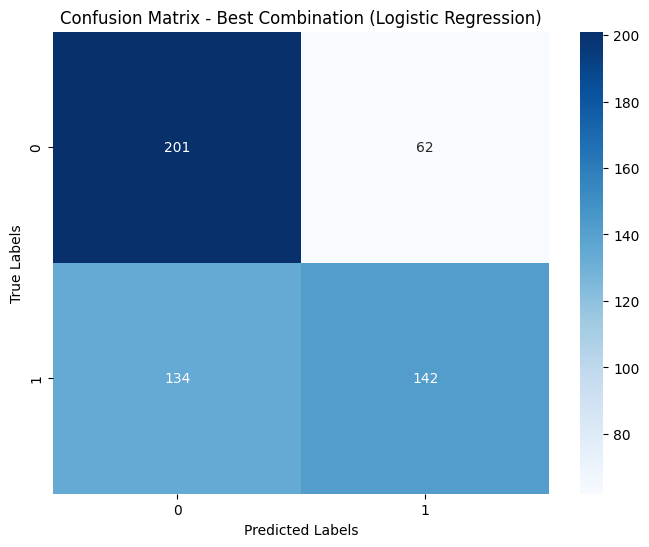

Best Combination (Logistic Regression):
Features: ['loan_investment_amount', 'metro_type', 'lender_type_category', 'optional_primary_use_of_funds', 'optional_revenue_yr_confirmed', 'optional_stage']
Accuracy: 0.6363636363636364
Precision: 0.696078431372549
Recall: 0.5144927536231884
F1 Score: 0.5916666666666667


In [89]:
import seaborn as sns
# Find the best combination based on the score
best_combination_lr = max(evaluation_results_lr, key=lambda x: score_combination(x))

# Plot confusion matrix for the best combination
best_features_lr = best_combination_lr['Features'].split(', ')
best_conf_matrix_lr = best_combination_lr['Confusion Matrix']

plt.figure(figsize=(8, 6))
sns.heatmap(best_conf_matrix_lr, annot=True, cmap='Blues', fmt='d')
plt.title('Confusion Matrix - Best Combination (Logistic Regression)')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# Print the best combination and its evaluation metrics
print("Best Combination (Logistic Regression):")
print("Features:", best_features_lr)
print("Accuracy:", best_combination_lr['Accuracy'])
print("Precision:", best_combination_lr['Precision'])
print("Recall:", best_combination_lr['Recall'])
print("F1 Score:", best_combination_lr['F1 Score'])

In [122]:

# Initialize an empty list to store evaluation results for each combination
evaluation_results = []

# Iterate over each top 10 combination
for index, row in top_10_gb_combinations.iterrows():
    features = row['Feature'].split(', ')

    # Fit the model on the training set with the selected features
    xgb_model.fit(X_train1[features], y_train1)
    
    # Predict the target variable using the fitted model on the testing set
    xgb_predictions = xgb_model.predict(X_test1[features])

    # Calculate evaluation metrics
    accuracy = accuracy_score(y_test1, xgb_predictions)
    precision = precision_score(y_test1, xgb_predictions)
    recall = recall_score(y_test1, xgb_predictions)
    f1 = f1_score(y_test1, xgb_predictions)
    conf_matrix = confusion_matrix(y_test1, xgb_predictions)

    # Store evaluation results for this combination
    evaluation_results.append({
        'Features': ', '.join(features),
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1,
        'Confusion Matrix': conf_matrix
        
    })

# Convert evaluation results to DataFrame for analysis
evaluation_results_df = pd.DataFrame(evaluation_results)

# Display evaluation results for each combination
print(evaluation_results_df)

                                            Features  Accuracy  Precision  \
0  unique_id, disbursement_date, lender_insurance...  0.981447   0.981884   
1  unique_id, disbursement_date, lender_insurance...  0.981447   0.981884   
2  unique_id, disbursement_date, lender_insurance...  0.981447   0.981884   
3  unique_id, disbursement_date, lender_insurance...  0.981447   0.981884   
4  unique_id, disbursement_date, lender_insurance...  0.981447   0.981884   
5  unique_id, disbursement_date, lender_insurance...  0.981447   0.981884   
6  unique_id, disbursement_date, full_time_employ...  0.981447   0.975000   
7  unique_id, disbursement_date, full_time_employ...  0.981447   0.975000   
8  unique_id, disbursement_date, full_time_employ...  0.981447   0.975000   
9  unique_id, disbursement_date, full_time_employ...  0.981447   0.975000   

     Recall  F1 Score      Confusion Matrix  
0  0.981884  0.981884  [[258, 5], [5, 271]]  
1  0.981884  0.981884  [[258, 5], [5, 271]]  
2  0.981884  0

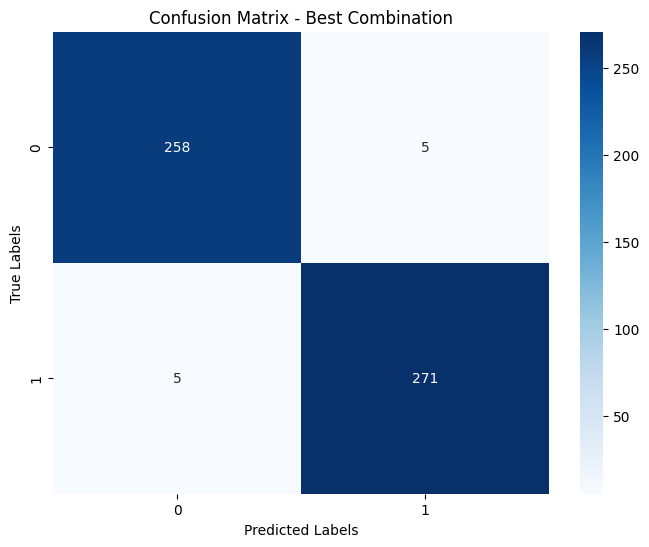

Best Combination:
Features: ['unique_id', 'disbursement_date', 'lender_insurance_premium', 'jobs_created', 'optional_revenue_yr_confirmed', 'optional_stage']
Accuracy: 0.9814471243042672
Precision: 0.9818840579710145
Recall: 0.9818840579710145
F1 Score: 0.9818840579710145


In [125]:

# Find the best combination based on the score
best_combination = max(evaluation_results, key=lambda x: score_combination(x))

# Plot confusion matrix for the best combination
best_features = best_combination['Features'].split(', ')
best_conf_matrix = best_combination['Confusion Matrix']

plt.figure(figsize=(8, 6))
sns.heatmap(best_conf_matrix, annot=True, cmap='Blues', fmt='d')
plt.title('Confusion Matrix - Best Combination')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# Print the best combination and its evaluation metrics
print("Best Combination:")
print("Features:", best_features)
print("Accuracy:", best_combination['Accuracy'])
print("Precision:", best_combination['Precision'])
print("Recall:", best_combination['Recall'])
print("F1 Score:", best_combination['F1 Score'])


In [128]:
scaled_forecast_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2692 entries, 0 to 2691
Data columns (total 15 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   unique_id                      2692 non-null   float64
 1   disbursement_date              2692 non-null   float64
 2   loan_investment_amount         2692 non-null   float64
 3   lender_insurance_premium       2692 non-null   float64
 4   metro_type                     2692 non-null   float64
 5   LMI_type                       2692 non-null   float64
 6   revenue                        2692 non-null   float64
 7   full_time_employees            2692 non-null   float64
 8   naics_code                     2692 non-null   float64
 9   jobs_created                   2692 non-null   float64
 10  lender_type_category           2692 non-null   float64
 11  optional_primary_use_of_funds  2692 non-null   float64
 12  optional_revenue_yr_confirmed  2692 non-null   f

In [129]:
scaled_train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4036 entries, 0 to 4035
Data columns (total 15 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   unique_id                      4036 non-null   float64
 1   disbursement_date              4036 non-null   float64
 2   loan_investment_amount         4036 non-null   float64
 3   lender_insurance_premium       4036 non-null   float64
 4   metro_type                     4036 non-null   float64
 5   LMI_type                       4036 non-null   float64
 6   revenue                        4036 non-null   float64
 7   full_time_employees            4036 non-null   float64
 8   naics_code                     4036 non-null   float64
 9   jobs_created                   4036 non-null   float64
 10  lender_type_category           4036 non-null   float64
 11  optional_primary_use_of_funds  4036 non-null   float64
 12  optional_revenue_yr_confirmed  4036 non-null   f

In [147]:
# Initialize an empty list to store evaluation results for each combination
evaluation_results_rf = []

# Iterate over each top 10 combination
for index, row in top_10_rf_combinations.iterrows():
    features = row['Feature'].split(', ')

    # Fit the model on the training set with the selected features
    rf_model.fit(X_train1[features], y_train1)
    
    # Predict the target variable using the fitted model on the testing set
    rf_predictions = rf_model.predict(X_test1[features])

    # Calculate evaluation metrics
    accuracy = accuracy_score(y_test1, rf_predictions)
    precision = precision_score(y_test1, rf_predictions)
    recall = recall_score(y_test1, rf_predictions)
    f1 = f1_score(y_test1, rf_predictions)
    conf_matrix = confusion_matrix(y_test1, rf_predictions)

    # Score the combination
    combination_metrics = {
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

    # Store evaluation results for this combination
    evaluation_results_rf.append({
        'Features': ', '.join(features),
        'Accuracy': accuracy,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1,
        'Confusion Matrix': conf_matrix,
      
    })

# Convert evaluation results to DataFrame for analysis
evaluation_results_rf_df = pd.DataFrame(evaluation_results_rf)


# Display evaluation results for each combination
print(evaluation_results_rf_df)


                                            Features  Accuracy  Precision  \
0  unique_id, loan_investment_amount, lender_insu...  0.987013   0.985560   
1  unique_id, loan_investment_amount, lender_insu...  0.983302   0.981949   
2  unique_id, loan_investment_amount, lender_insu...  0.988868   0.989130   
3  unique_id, loan_investment_amount, lender_insu...  0.992579   0.992754   
4  unique_id, loan_investment_amount, lender_insu...  0.988868   0.989130   
5  unique_id, loan_investment_amount, lender_insu...  0.987013   0.985560   
6  unique_id, loan_investment_amount, lender_insu...  0.988868   0.989130   
7  unique_id, loan_investment_amount, lender_insu...  0.987013   0.989091   
8  unique_id, loan_investment_amount, lender_insu...  0.987013   0.989091   
9  unique_id, loan_investment_amount, lender_insu...  0.987013   0.989091   

     Recall  F1 Score      Confusion Matrix  
0  0.989130  0.987342  [[259, 4], [3, 273]]  
1  0.985507  0.983725  [[258, 5], [4, 272]]  
2  0.989130  0

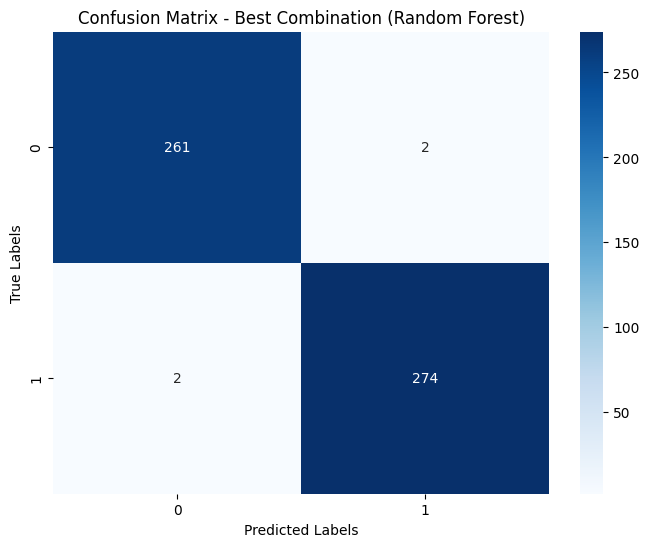

Best Combination (Random Forest):
Features: ['unique_id', 'loan_investment_amount', 'lender_insurance_premium', 'jobs_created', 'lender_type_category']
Accuracy: 0.9925788497217068
Precision: 0.9927536231884058
Recall: 0.9927536231884058
F1 Score: 0.9927536231884058


In [152]:
# Find the best combination based on the score
best_combination_rf = max(evaluation_results_rf, key=lambda x: score_combination(x))

# Plot confusion matrix for the best combination
best_features_rf = best_combination_rf['Features'].split(', ')
best_conf_matrix_rf = best_combination_rf['Confusion Matrix']

plt.figure(figsize=(8, 6))
sns.heatmap(best_conf_matrix_rf, annot=True, cmap='Blues', fmt='d')
plt.title('Confusion Matrix - Best Combination (Random Forest)')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# Print the best combination and its evaluation metrics
print("Best Combination (Random Forest):")
print("Features:", best_features_rf)
print("Accuracy:", best_combination_rf['Accuracy'])
print("Precision:", best_combination_rf['Precision'])
print("Recall:", best_combination_rf['Recall'])
print("F1 Score:", best_combination_rf['F1 Score'])

In [153]:
# Predict the probabilities of each individual being in class 1 (risk)
forecast_probabilities = rf_model.predict_proba(scaled_forecast_df[best_features_rf])[:, 1]

# Assuming FICO score ranges from 300 to 850
fico_min = 300
fico_max = 900

# Deduce the FICO score based on the probability of risk
forecast_fico_scores = fico_min + (fico_max - fico_min) * (1 - forecast_probabilities)

# Truncate the deduced FICO scores to integers
forecast_fico_scores = forecast_fico_scores.astype(int)

# Combine the predicted FICO scores with individual IDs and credit scores
forecast_with_scores = forecast_df[['unique_id']].copy()
forecast_with_scores['FICO_Score'] = forecast_fico_scores

# Display the top individuals
top_individuals = forecast_with_scores.head(10)
print("Top Individuals with Truncated FICO Scores:")
print(top_individuals) 

Top Individuals with Truncated FICO Scores:
       unique_id  FICO_Score
10952       1354         306
2132         212         894
11837       2003         330
10933       1227         306
17581       3507         894
11922       2087         876
6129         505         900
11679       1826         900
10646       1073         306
16562       2893         852


In [154]:
# Specify the file path for saving the CSV file
csv_file_path = "forecast_fico_scores.csv"

# Save the DataFrame with FICO scores and IDs to a CSV file
forecast_with_scores.to_csv(csv_file_path, index=False)

print(f"Forecast FICO scores saved to '{csv_file_path}'.")


Forecast FICO scores saved to 'forecast_fico_scores.csv'.
